# Notes for users:
Before using this notebook **FOR THE FIRST TIME**, you should have:
0. pre-compiled SimpleElastix, [instructions here](https://simpleelastix.readthedocs.io/)
1. Make sure you have conda installed on your computer, [instructions here](https://conda.io/projects/conda/en/latest/user-guide/install/index.html)
2. create a conda environment based on the instructions in the rat_BrainPipe repo    

Before using this notebook **EVERY TIME**:
0. activate your lightsheet conda environment `conda activate lightsheet`
1. an atlas directory - for Brody lab this is a directory in bucket, in `lightsheet/atlas_directory`
2. a slice directory - **WITH CROPPED SLICES!** please make sure your slices are all cropped so only one brain slice is visible in each file, and no slide edges are visible. This is ESSENTIAL to getting a nice fit.
3. you **MUST CHANGE THE USER INPUTS SECTION** unless you are on Emily's laptop

This notebook has a few slow steps, but it takes ~15 minutes to run for a group of 24 slices on a 2016 Mac running Big Sur with 16GB RAM and 3.3 GHz i7.

# Imports

In [1]:
import os
import numpy as np
import tifffile as tif
import SimpleITK as sitk
import sys
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
from collections import namedtuple
from glob import glob
from scipy import ndimage
from scipy.ndimage import zoom

# User inputs

In [2]:
# pick your atlas directory here
atlas_directory = "/Users/emilydennis/Desktop/atlasdir" # this should be bucket
slice_directory = "/Users/emilydennis/Desktop/slicedir/A243/"
save_directory = "/Users/emilydennis/Desktop/savedir"

assert os.path.exists(atlas_directory), "cannot find atlas_directory"
assert os.path.exists(slice_directory), "cannot find slice_directory"
os.makedirs(save_directory, exist_ok=True)

# Slice rotation upon loading - change as needed:
# rotation = 90 # if top of brain is on the right
slice_rotation = -90 # if top of the brain is on the left

# choose the directionality of your slices by commenting/uncommenting as needed:
#slice_direction = 'axial'
#slice_direction = 'sagittal'
slice_direction = 'coronal'

# Define functions

In [3]:
def use_user_input(num,comp_list):
    return comp_list[num]

In [4]:
def plot_for_user(numrows,numcols,imgs_to_cmp,slclist,list_of_vols_to_compare):
    fig, axs = plt.subplots(numrows,numcols,figsize=(20,10*numrows))
    for i in np.arange(numrows):
        img_to_cmp_full=imgs_to_cmp[0] if len(imgs_to_cmp)==1 else imgs_to_cmp[i]
        img_to_cmp = img_to_cmp_full[::10,::10]
        axs[i,0].imshow(img_to_cmp,cmap='gray')
        axs[i,0].imshow(img_to_cmp,cmap='gray')
        axs[i,0].imshow(img_to_cmp,cmap='gray')
        
        voltoplot=list_of_vols_to_compare[0] if len(list_of_vols_to_compare)==1 else list_of_vols_to_compare[i]
        slc=slclist[0] if len(slclist)==1 else slclist[i]
        
        axs[i,1].imshow(voltoplot[:,slc,:],cmap='gray')
        axs[i,1].title.set_text(str(i))
        axs[i,1].title.set_size(40)

In [5]:
def rotated_imports(full_path_to_atlas,slice_direction):
    if slice_direction == 'coronal':
        atl = np.swapaxes(tif.imread(full_path_to_atlas),0,2)
    elif slice_direction == 'sagittal':
        atl = np.swapaxes(tif.imread(full_path_to_atlas),0,1)
    elif slice_direction == 'axial':
        atl = np.swapaxes(tif.imread(full_path_to_atlas),1,2).T
    else:
        print("OOPS you need to define slice_direction in the User inputs section as either 'coronal','sagittal', or 'axial'")
    return(atl)

In [6]:
def rotate_and_save(atl,atlas_name,out_name,angle,axes):
    atl_rot = atl.copy()
    np.save(os.path.join(atlas_directory,'{}_{}'.format(atlas_name,out_name)),ndimage.rotate(atl_rot,angle,axes=axes))

In [7]:
def align_slice_to_atl(best_volume_slice,tiff_slice):
    [x,y]=np.shape(tiff_slice)
    [vx,vy] = np.shape(best_volume_slice)
    # alignment is improved if images are roughly the same size
    mv = zoom(tiff_slice,vy/y)
    
    #set fixed and moving images
    fixedImage = sitk.GetImageFromArray(best_volume_slice)
    movingImage = sitk.GetImageFromArray(mv)
    
    # set Elastix params
    parameterMap= sitk.GetDefaultParameterMap('affine')
    parameterMap['MaximumNumberOfIterations'] = ['512']
    bsplineMap = sitk.GetDefaultParameterMap('bspline')
    parameterMap['FixedImagePyramidSchedule']= ['32 32 32 8 8 8 2 2 2 1 1 1']
    parameterMap['NumberOfResolutions'] = ['4']
    parameterMap['Metric']=["AdvancedMattesMutualInformation"]
    parameterMap['AutomaticTransformInitialization']=['true']
    parameterMap['AutomaticTransformInitializationMethod']=['CenterOfGravity']

    bsplineMap['FixedImagePyramidSchedule']= ['32 32 32 8 8 8 2 2 2 1 1 1']
    bsplineMap['NumberOfResolutions'] = ['4']
    bsplineMap['Metric']=["AdvancedMattesMutualInformation"]
    bsplineMap['AutomaticTransformInitialization']=['true']
    bsplineMap['AutomaticTransformInitializationMethod']=['CenterOfGravity']
    
    elastixImageFilter = sitk.ElastixImageFilter()
    elastixImageFilter.SetFixedImage(fixedImage)
    elastixImageFilter.SetMovingImage(movingImage)
    elastixImageFilter.SetParameterMap(parameterMap)
    elastixImageFilter.AddParameterMap(bsplineMap)
    elastixImageFilter.AddParameterMap(bsplineMap)
    
    # run Elastix alignment
    elastixImageFilter.Execute()
    
    resultImage = elastixImageFilter.GetResultImage()
    transformParameterMap = elastixImageFilter.GetTransformParameterMap()
    
    return resultImage, transformParameterMap

# Load data
If you want to add your own atlas, you need to give it a name, paths to the registration volume, annotation volume, and labels csv which should all be in `atlas_directory`. Add your new variable to `atl_list` and your new name to `atl_name_list` in **6 pick atlas** Then follow the examples below. 

In [8]:
Atlas = namedtuple("Atlas", ["name","registration", "annotation", "labels"])

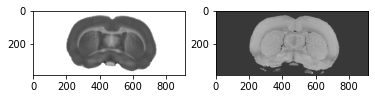

In [378]:
# warning! This is one of the slow cells. Please be patient!

sigma = Atlas(
    name = 'sigma',
    registration= rotated_imports(os.path.join(atlas_directory,'sigma_reg_whitebkrd.tif'),slice_direction),
    annotation = rotated_imports(os.path.join(atlas_directory,'mPRA_SIGMA_annotation-volume.tif'), slice_direction),
    labels = pd.read_csv(os.path.join(atlas_directory,'SIGMA_labels_withPRA.csv')))

inv_sigreg = sigma.registration.copy()
inv_sigreg[inv_sigreg==0]=np.max(sigma.registration)+20

whs = Atlas(
    name = 'whs',
    registration=rotated_imports(os.path.join(atlas_directory,'mPRA_WHS_registration-volume.tif'),slice_direction),
    annotation = rotated_imports(os.path.join(atlas_directory,'WHS_ann_in_mPRA.tif'),slice_direction),
    labels= pd.read_csv(os.path.join(atlas_directory,'WHS_labels.csv')))

inv_whsreg = whs.registration.copy()
inv_whsreg[inv_whsreg==0]=np.max(whs.registration)+20


fig, (ax1, ax2) = plt.subplots(ncols=2)
ax1.imshow(sigma.registration[:, 400, :], cmap = 'gray')
ax2.imshow(whs.registration[:, 400, :], cmap = 'gray')

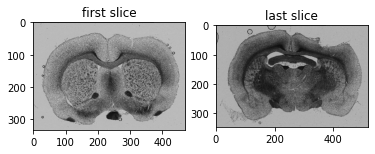

In [10]:
tiff_files = sorted(glob(slice_directory + "/*.tif*"))
assert len(tiff_files) >= 2, "there are not two tiff files in slice_directory"

# load data, pick first/last slices
first = ndimage.rotate(tif.imread(tiff_files[0])[0],slice_rotation) # channel 0 of first tiff
last = ndimage.rotate(tif.imread(tiff_files[-1])[0],slice_rotation) # channel 0 of last tiff

# plot first and last slice
fig, (ax1, ax2) = plt.subplots(ncols=2);
ax1.imshow(first[::10,::10], cmap='gray');
ax1.set_title('first slice');
ax2.imshow(last[::10,::10], cmap='gray');
ax2.set_title('last slice');

# Pick atlas

<span style="color:red">
which image looks most like your slices? 
*pay extra attention to hippocampal features, ventricles that are bright or dark* </span>

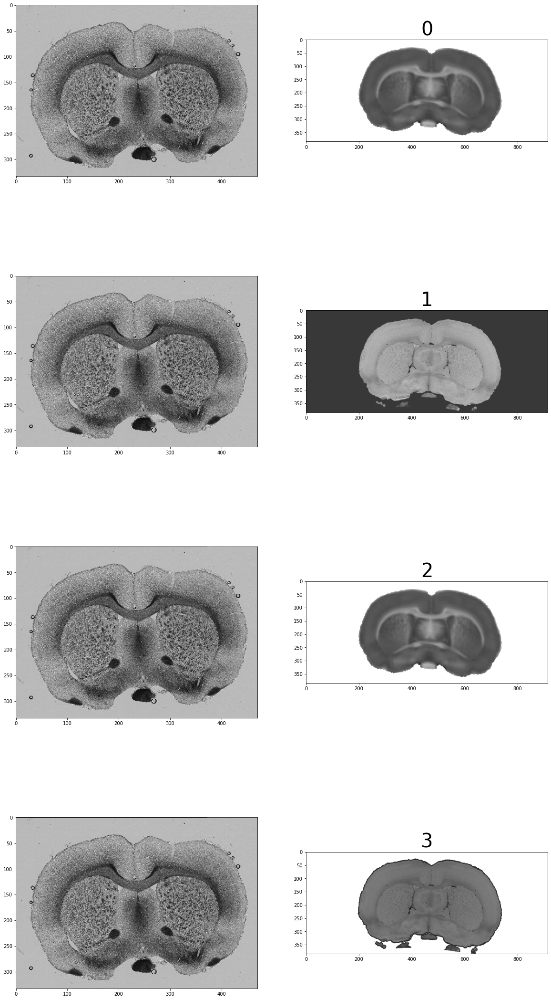

In [422]:
atl_list = [sigma.registration,whs.registration,inv_sigreg,inv_whsreg]
atl_name_list = ['sigma','whs','inv_sig','inv_whs']
plot_for_user(len(atl_list),2,[first],[400],atl_list);

In [423]:
atl = use_user_input(3,atl_list) ## change 0,1,2.. depending on which looks best above
atlas_name = use_user_input(3,atl_name_list) ## change 0,1,2.. depending on which looks best above

# Pick first slice

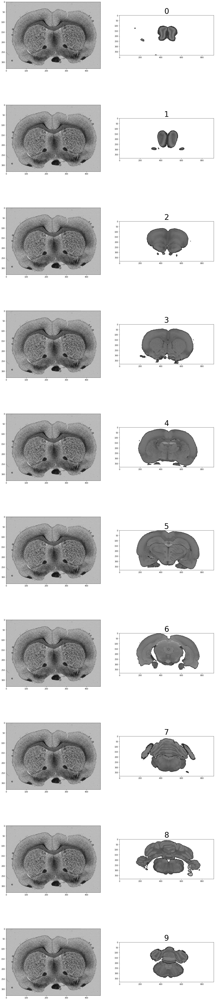

In [398]:
slclist=[]

for i in np.arange(0,10):
    slclist.append(int(np.shape(atl)[1]/11*i)+50)
plot_for_user(10,2,[first],slclist,[atl]);

In [400]:
bestslice = use_user_input(3,slclist)
print(bestslice)

345


### Repeat process with smaller increments closer to the real slice location

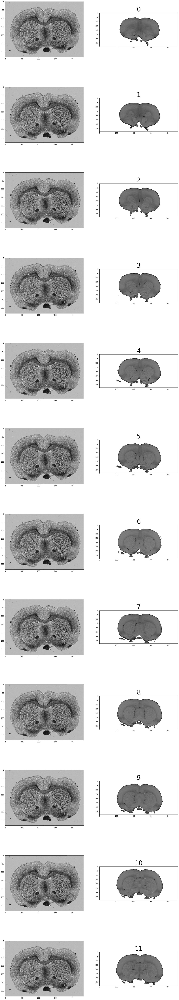

In [401]:
slclist=[]
for i in np.arange(0,12):
    slclist.append(int(bestslice)+(10*(i-5)))
plot_for_user(12,2,[first],slclist,[atl])

In [405]:
bestslice = use_user_input(8,slclist)
print(bestslice)

375


### repeat process with smaller increments closer to the real slice location
*hint* if you're struggling, scroll through quickly first and try to notice features that change a lot between the first and last option. Focus on those.

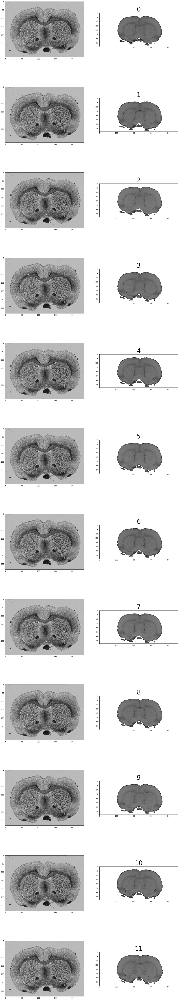

In [406]:
slclist=[]
for i in np.arange(0,12):
    slclist.append(int(bestslice+(2*(i-5))))
plot_for_user(12,2,[first],slclist,[atl])

In [407]:
bestslice = use_user_input(7,slclist)
first_slc=bestslice
print(first_slc)

379


# Pick last slice

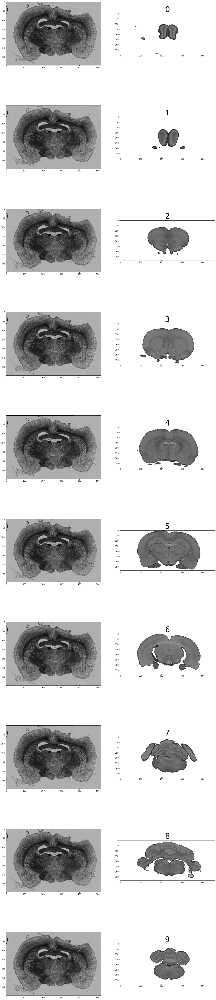

In [410]:
slclist=[]
for i in np.arange(0,10):
    slclist.append((int(np.shape(atl)[1]/11)*i)+50)
plot_for_user(10,2,[last],slclist,[atl])

In [411]:
bestslice = use_user_input(4,slclist)
print(bestslice)

442


### Repeat process with smaller increments closer to the real slice location

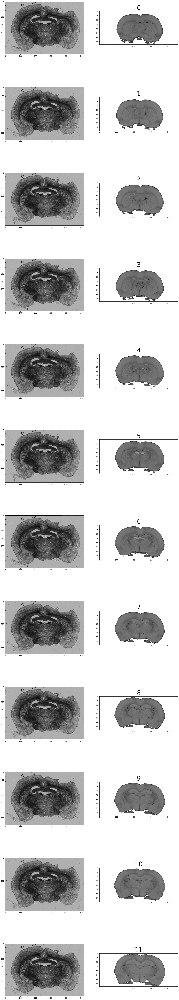

In [412]:
slclist=[]
for i in np.arange(0,12):
    slclist.append(int(bestslice)+(10*(i-5)))
plot_for_user(12,2,[last],slclist,[atl])

In [413]:
bestslice = use_user_input(5,slclist)
print(bestslice)

442


### Repeat process with smaller increments closer to the real slice location

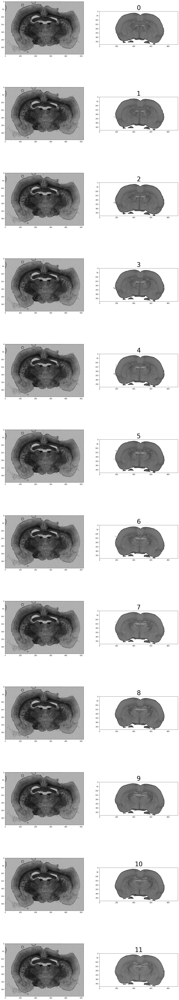

In [414]:
slclist=[]
for i in np.arange(0,12):
    slclist.append(int(bestslice+(2*(i-5))))
plot_for_user(12,2,[last],slclist,[atl])

In [416]:
bestslice = use_user_input(4,slclist)
last_slc=bestslice
print(last_slc)

440


# Make montage of all slices and equivalents

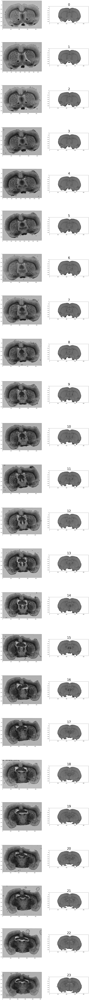

In [14]:
# warning, this is a slow step. Please be patient!

frc = (last_slc-first_slc)/len(tiff_files)
slclist=[]
tiflist = []

for i in np.arange(len(tiff_files)):
    xx=int(first_slc+(frc*i))
    slclist.append(xx)
    print
    tifin=tif.imread(tiff_files[i])[0]
    tiflist.append(ndimage.rotate(tifin,slice_rotation))
    
plot_for_user(len(tiff_files),2,tiflist,slclist,[atl])

# If that looks reasonable, now check slice angles
Emily has pre-computed Brody lab atlas volumes at various common slice angles as the rotation of matrices is slow.
If you add an atlas and need to pre-compute these volumes, Emily included a `rotate_and_save` function. An example call of this function:
`atlas_name = 'whs'
rotate_and_save(atl,atlas_name,'m2',-2,(0,1))`

In [19]:
# load precomputed volumes
m2 = np.load(os.path.join(atlas_directory,"{}_{}.npy".format(atlas_name,'m2')))
m5= np.load(os.path.join(atlas_directory,"{}_{}.npy".format(atlas_name,'m5')))
m8= np.load(os.path.join(atlas_directory,"{}_{}.npy".format(atlas_name,'m8')))
m10= np.load(os.path.join(atlas_directory,"{}_{}.npy".format(atlas_name,'m10')))
p2 = np.load(os.path.join(atlas_directory,"{}_{}.npy".format(atlas_name,'p2')))
p5=np.load(os.path.join(atlas_directory,"{}_{}.npy".format(atlas_name,'p5')))
p8=np.load(os.path.join(atlas_directory,"{}_{}.npy".format(atlas_name,'p8')))
p10=np.load(os.path.join(atlas_directory,"{}_{}.npy".format(atlas_name,'p10')))

# generate variables based on imported volumes
slc=first_slc
shp = np.shape(atl)[1]
frc=slc/shp

shp2=np.shape(m2)[1]
shp5=np.shape(m5)[1]
shp8 = np.shape(m8)[1]
shp10=np.shape(m10)[1]

resliced_vol_list=[m10,m8,m5,m2,atl,p2,p5,p8,p10]
shape_list = [shp10,shp8,shp5,shp2,slc,shp2,shp5,shp8,shp10]
name_list = ['m10','m8','m5','m2','zero','p2','p5','p8','p10']

assert len(resliced_vol_list)==len(shape_list), "oops resliced_vol_list and shape_list aren't equal in length! please fix"
print("if there were no warnings, you're ready to plot!")

if there were no warnings, you're ready to plot!


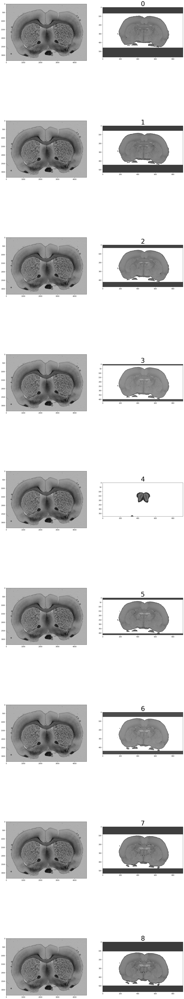

In [430]:
fig, axs = plt.subplots(9,2,figsize=(20,120))

for i in np.arange(0,len(resliced_vol_list)):
    axs[i,1].imshow(resliced_vol_list[i][:,int(frc*shape_list[i]),:],cmap='gray')
    axs[i,1].title.set_text(str(i))
    axs[i,1].title.set_size(40)
    axs[i,0].imshow(first,cmap='gray')

In [20]:
#which volume is closest? change user_input value!

user_input = 7 

best_vol = use_user_input(user_input,resliced_vol_list)
best_vol_shp = shape_list[user_input]
print("the volume you chose is at angle {} where m= negative and p=positive".format(name_list[user_input]))

the volume you chose is at angle p8 where m= negative and p=positive


# Check final slice with slice angle

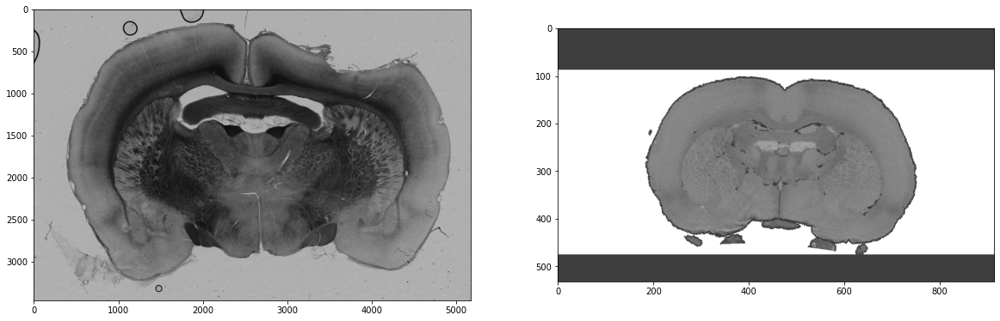

In [442]:
frc=last_slc/shp
fig, axs = plt.subplots(1,2,figsize=(20,120))

axs[1].imshow(best_vol[:,int(frc*best_vol_shp),:],cmap='gray')
axs[0].imshow(last,cmap='gray')

# Now align each slice to its best match with SimpleElastix
TODO: make into fx - run for each slice

In [21]:
resultlist=[]
# run Elastix - warning, this is the slowest step!! Please be very patient.

for i in np.arange(0,len(tiflist)):
    print("starting {} of {}".format(i,len(tiflist)))
    frc = slclist[i]/shp
    result, transformmap = align_slice_to_atl(best_vol[:,int(frc*best_vol_shp),:],tiflist[i])
    resultlist.append(result)
    print("algined {} of {}".format(i,len(tiflist)))

starting 0 of 24


AttributeError: module 'SimpleITK' has no attribute 'GetDefaultParameterMap'

In [452]:
#now plot then save out

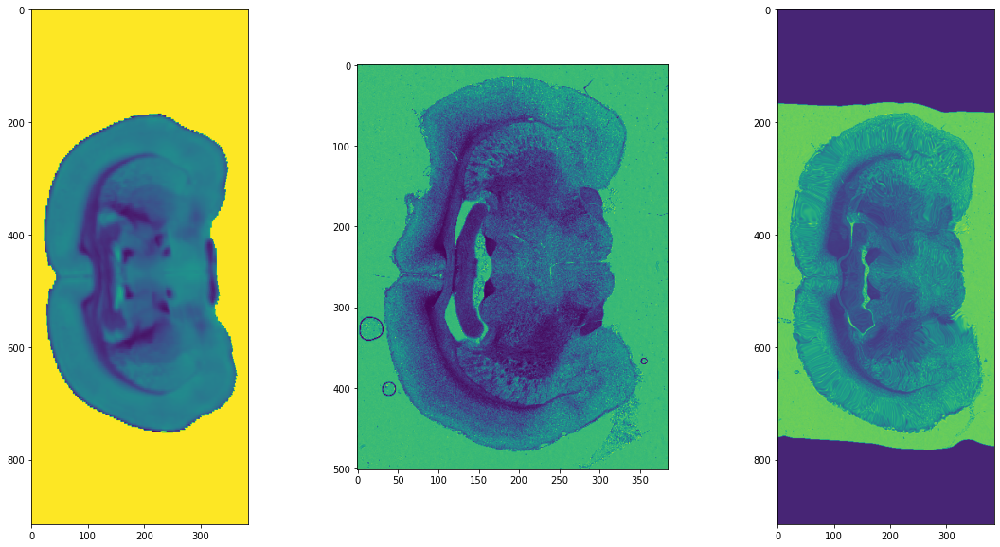

In [234]:
fig, axs = plt.subplots(1,3,figsize=(20,10));
axs[0].imshow(sitk.GetArrayFromImage(fixedImage))
axs[1].imshow(sitk.GetArrayFromImage(movingImage))
axs[2].imshow(sitk.GetArrayFromImage(resultImage))

# add diff atlas as overlays/sep options
TODO

# save stuff
TO IMPROVE

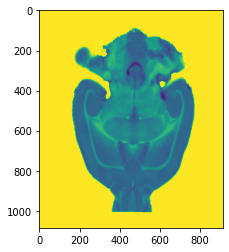

In [ ]:
# save stuff
tif.imsave('/Users/emilydennis/Desktop/test.tif',sitk.GetArrayFromImage(resultImage))

# make transfer of pts option (e.g. slice 2 at (x,y) in atlas coords)
TODO